# Correlación entre estaciones y propuesta de algunos modelos

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import numpy as np
from scipy.stats import pearsonr
from heatmap import heatmap, corrplot
import plotly.express as px

In [2]:
location = pd.read_excel("Data/cat.xlsx")
meteo = pd.read_csv("Data/meteorologyAll.csv")[['dateUTCShiftedDown', 'original',
                                                'id_parameter_id', 'id_station_id']]
poll = pd.read_csv("Data/pollutantsAll.csv")[['dateUTCShiftedDown', 'original',
                                                'id_parameter_id', 'id_station_id']]
meteo["dateUTCShiftedDown"] = pd.to_datetime(meteo["dateUTCShiftedDown"])
poll["dateUTCShiftedDown"] = pd.to_datetime(poll["dateUTCShiftedDown"])

Se tomaron las mejores estaciones del 2019, según el análisis de Sara. Y se consideraron valores entre las 6AM y 9PM

In [3]:
#st = ['VIF', 'TAH', 'XAL', 'MGH', 'UAX', 'UIZ', 'TLA', 'AJM', 'SAC', 'BJU', 'SFE', 'CUT', 'CUA', 'MON', 'FAC', 'SAG', 'PED', 'NEZ', 'MER',
#      'HGM', 'SUR', 'TPN']

#st_20 = ["PED", "SFE", "UIZ", "CAM", "TLA", "MER", "SAG", "FAC", "VIF", "NEZ"]
st_19 = ["MER", "AJM", "PED", "SFE", "XAL", "HGM", "TLA", "FAC", "VIF", "MGH", "TAH", "MON", "CUA", "CUT", "UIZ", "NEZ", "UAX", "GAM", "SAG",
         "BJU", "MPA", "ACO", "SAC", "CCA", "INN", "CHO", "TLI", "LLA", "ATI", "CAM", "FAR"]
#st_18 = ["MER", "AJM", "PED", "SFE", "XAL", "HGM", "TLA", "FAC", "VIF", "MGH", "TAH", "MON", "CUA", "CUT", "UIZ", "NEZ", "UAX", "GAM", "SAG",
#         "BJU", "MPA", "ACO", "IZT", "CCA", "INN", "CHO", "TLI", "LLA", "ATI", "CAM", "LAA"]

meteo = meteo[(meteo["dateUTCShiftedDown"].dt.hour<22)&(meteo["dateUTCShiftedDown"].dt.hour>5)&(meteo["id_station_id"].isin(st_19))]
poll = poll[(poll["dateUTCShiftedDown"].dt.hour<22)&(poll["dateUTCShiftedDown"].dt.hour>5)&(poll["id_station_id"].isin(st_19))]

## Correlación por estación


Muestra aleatoria de valores de estaciones por cada hora

In [18]:
estacion_meteo = pd.DataFrame()
estacion_poll = pd.DataFrame()
for station in st_19:
    if (station != "CCA") and (station != "TLI") and (station != "LLA") and (station != "ATI") and (station != "CAM"):
        estacion_meteo[station] = np.array(meteo[meteo["id_station_id"] == station].sample(21504)["original"])
    estacion_poll[station] = np.array(poll[poll["id_station_id"] == station].sample(75264)["original"])

Muestra aleatoria de valores de estaciones promedidas por día

In [23]:
estacion_meteo = pd.DataFrame()
estacion_poll = pd.DataFrame()
met1 = meteo.groupby(by=["id_station_id",pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean()
poll1 = poll.groupby(by=["id_station_id",pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean()
for station in st_19:
    if (station != "CCA") and (station != "TLI") and (station != "LLA") and (station != "ATI") and (station != "CAM"):
        estacion_meteo[station] = np.array(met1[station].to_frame().reset_index()["original"].sample(672))
    estacion_poll[station] = np.array(poll1[station].to_frame().reset_index()["original"].sample(672))

### Mejores estaciones del 2019 del análisis de Sara

#### Muestra aleatoria

Para la muestra alaetoria se observa que la correlación entre estaciones es mala a comparación de los siguientes casos que se consideraron

C:\Users\Jorge\AppData\Local\Temp/ipykernel_10208/830702320.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask_ut=np.triu(np.ones(estacion_meteo.corr().shape)).astype(np.bool)


Text(0.5, 1.0, 'Correlación meteorológica de las mejores estaciones promediadas por dia')

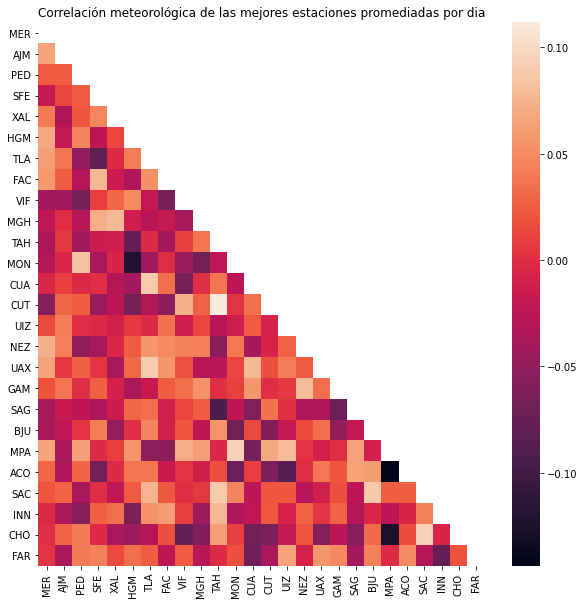

In [16]:
plt.figure(figsize=(10, 10))
mask_ut=np.triu(np.ones(estacion_meteo.corr().shape)).astype(np.bool)
sns.heatmap(estacion_meteo.corr(), mask=mask_ut)
plt.title("Correlación meteorológica de las mejores estaciones promediadas por dia")

Solo se mostraron en el mapa, estaciones con correlación > .4

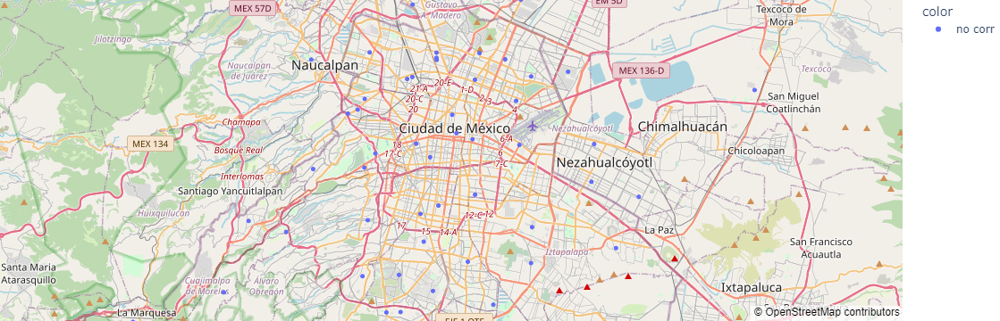

In [24]:
correlations = np.array(estacion_meteo.corr())
estaciones_corr = []
for i in range(len(st_19)-5):
    for j in range(i+1,len(st_19)-5):
        if correlations[i][j] >= 0.4:
            if (st_19[i] != "CCA") and (st_19[i] != "TLI") and (st_19[i] != "LLA") and (st_19[i] != "ATI") and (st_19[i] != "CAM"):
                estaciones_corr.append(st_19[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

C:\Users\Jorge\AppData\Local\Temp/ipykernel_10208/2514042090.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask_ut=np.triu(np.ones(estacion_poll.corr().shape)).astype(np.bool)


Text(0.5, 1.0, 'Correlación de contaminantes de las mejores estaciones promediadas por dia')

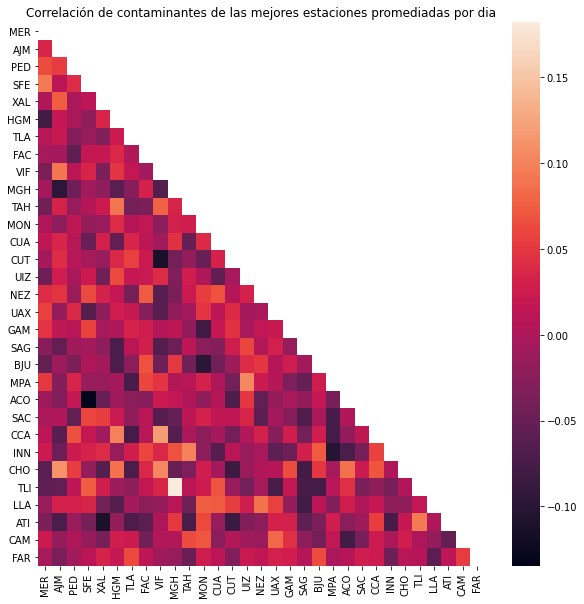

In [17]:
plt.figure(figsize=(10, 10))
mask_ut=np.triu(np.ones(estacion_poll.corr().shape)).astype(np.bool)
sns.heatmap(estacion_poll.corr(), mask=mask_ut)
plt.title("Correlación de contaminantes de las mejores estaciones promediadas por dia")

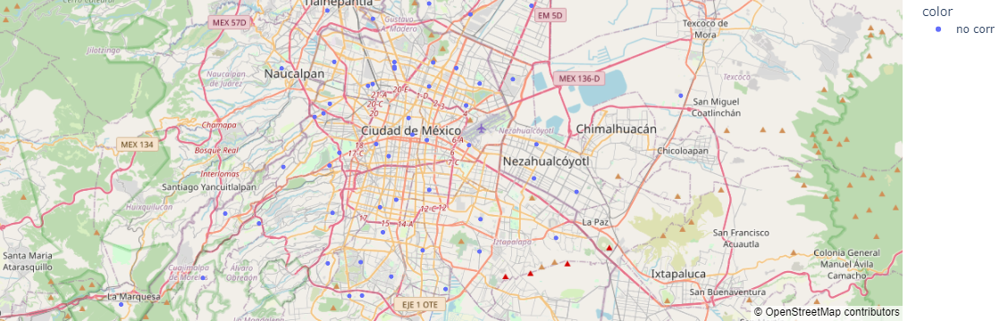

In [25]:
correlations = np.array(estacion_poll.corr())
estaciones_corr = []
for i in range(len(st)):
    for j in range(i+1,len(st)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

C:\Users\Jorge\AppData\Local\Temp/ipykernel_10208/1527723605.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask_ut=np.triu(np.ones(estacion_meteo.corr().shape)).astype(np.bool)


Text(0.5, 1.0, 'Correlación meteorológica de las mejores estaciones promediadas por hora')

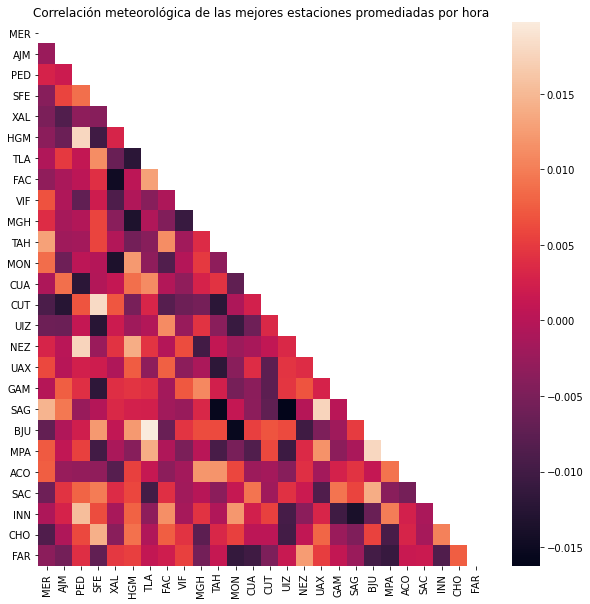

In [19]:
plt.figure(figsize=(10, 10))
mask_ut=np.triu(np.ones(estacion_meteo.corr().shape)).astype(np.bool)
sns.heatmap(estacion_meteo.corr(), mask=mask_ut)
plt.title("Correlación meteorológica de las mejores estaciones promediadas por hora")

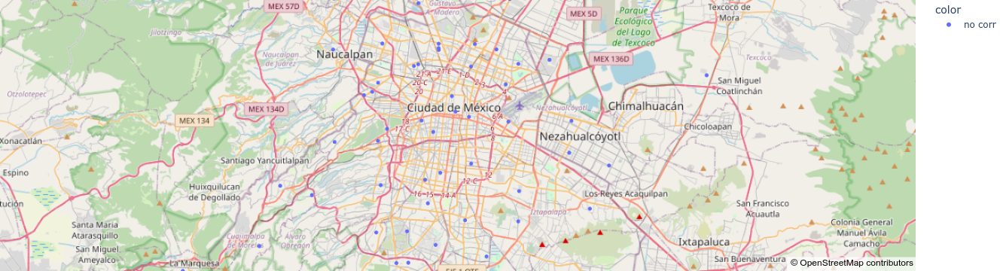

In [22]:
correlations = np.array(estacion_meteo.corr())
estaciones_corr = []
for i in range(len(st_19)-5):
    for j in range(i+1,len(st_19)-5):
        if correlations[i][j] >= 0.4:
            if (st_19[i] != "CCA") and (st_19[i] != "TLI") and (st_19[i] != "LLA") and (st_19[i] != "ATI") and (st_19[i] != "CAM"):
                estaciones_corr.append(st_19[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

C:\Users\Jorge\AppData\Local\Temp/ipykernel_10208/3865194078.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask_ut=np.triu(np.ones(estacion_poll.corr().shape)).astype(np.bool)


Text(0.5, 1.0, 'Correlación de contaminantes de las mejores estaciones promediadas por hora')

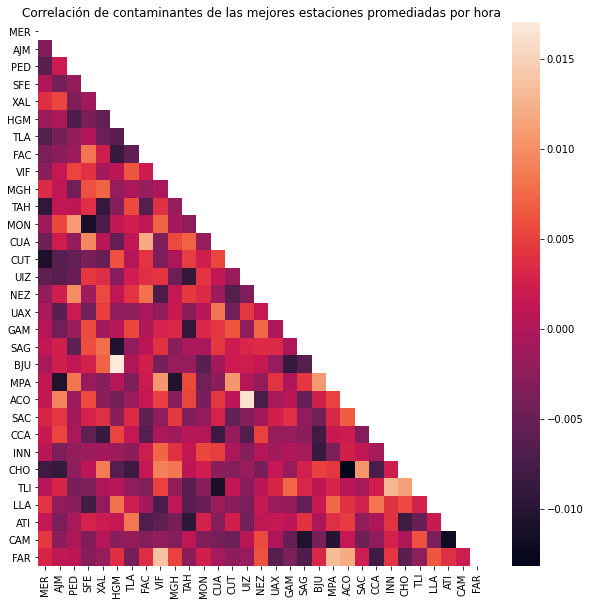

In [20]:
plt.figure(figsize=(10, 10))
mask_ut=np.triu(np.ones(estacion_poll.corr().shape)).astype(np.bool)
sns.heatmap(estacion_poll.corr(), mask=mask_ut)
plt.title("Correlación de contaminantes de las mejores estaciones promediadas por hora")

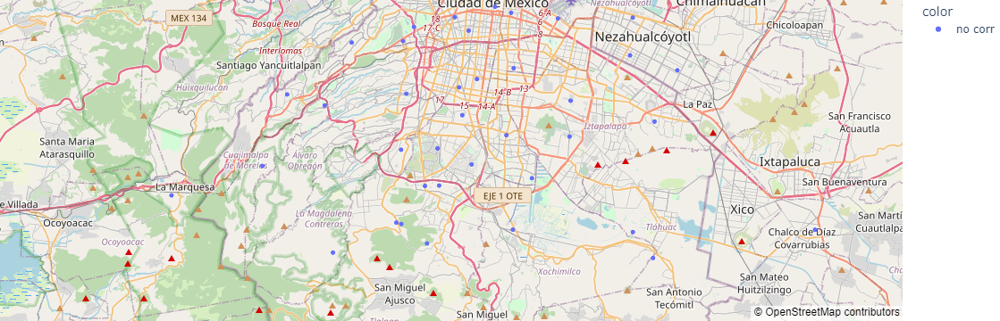

In [21]:
correlations = np.array(estacion_poll.corr())
estaciones_corr = []
for i in range(len(st)):
    for j in range(i+1,len(st)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

#### Últimos datos

Se tomaron tanto los últimos como los primeros datos (veáse más adelante) y se observó que la correlación mejora considerablemente, por lo que solo para aquellas estaciones en las que se toman valores de horas o días sucesivos se obtiene una correlación > .4

In [10]:
estacion_meteo = pd.DataFrame()
estacion_poll = pd.DataFrame()
for station in st_19:
    if (station != "CCA") and (station != "TLI") and (station != "LLA") and (station != "ATI") and (station != "CAM"):
        estacion_meteo[station] = np.array(meteo[meteo["id_station_id"] == station][-21504:-1]["original"])
    estacion_poll[station] = np.array(poll[poll["id_station_id"] == station][-75264:-1]["original"])

In [5]:
estacion_meteo = pd.DataFrame()
estacion_poll = pd.DataFrame()
met1 = meteo.groupby(by=["id_station_id",pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean()
poll1 = poll.groupby(by=["id_station_id",pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean()
for station in st_19:
    if (station != "CCA") and (station != "TLI") and (station != "LLA") and (station != "ATI") and (station != "CAM"):
        estacion_meteo[station] = np.array(met1[station].to_frame().reset_index()["original"][-672:-1])
    estacion_poll[station] = np.array(poll1[station].to_frame().reset_index()["original"][-672:-1])

C:\Users\Jorge\AppData\Local\Temp/ipykernel_6636/830702320.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask_ut=np.triu(np.ones(estacion_meteo.corr().shape)).astype(np.bool)


Text(0.5, 1.0, 'Correlación meteorológica de las mejores estaciones promediadas por dia')

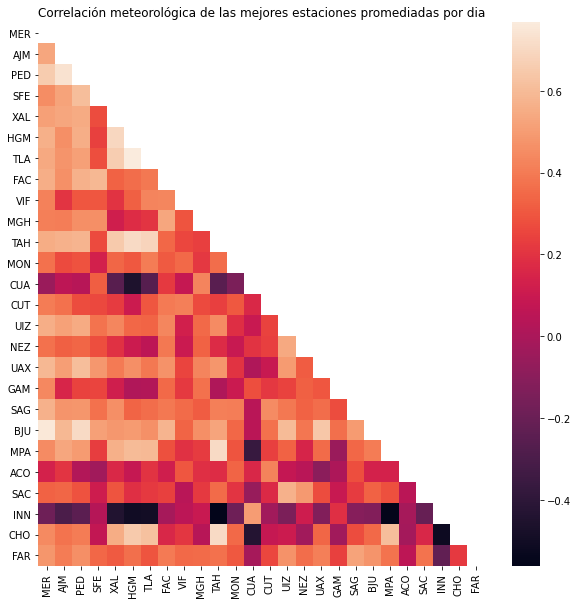

In [6]:
plt.figure(figsize=(10, 10))
mask_ut=np.triu(np.ones(estacion_meteo.corr().shape)).astype(np.bool)
sns.heatmap(estacion_meteo.corr(), mask=mask_ut)
plt.title("Correlación meteorológica de las mejores estaciones promediadas por dia")

Tanto en los últimos como en los primeros datos, se observa que la correlación de estaciones tiene una distribución espacial que corresponde a vías, carreteras, calles muy transitadas de la CDMX

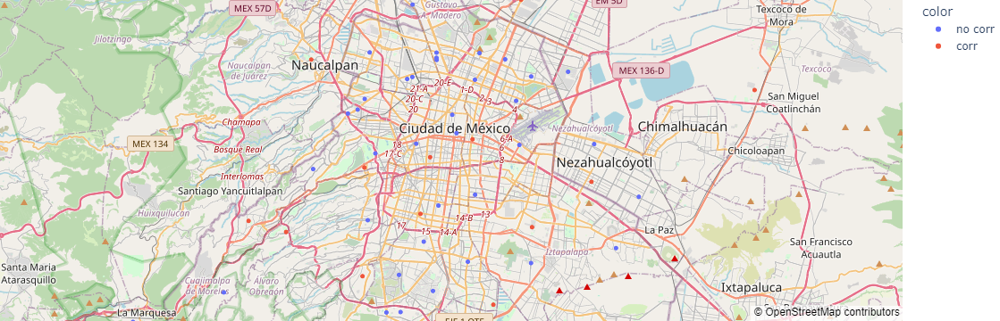

In [9]:
correlations = np.array(estacion_meteo.corr())
estaciones_corr = []
for i in range(len(st_19)-5):
    for j in range(i+1,len(st_19)-5):
        if correlations[i][j] >= 0.4:
            if (st_19[i] != "CCA") and (st_19[i] != "TLI") and (st_19[i] != "LLA") and (st_19[i] != "ATI") and (st_19[i] != "CAM"):
                estaciones_corr.append(st_19[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

C:\Users\Jorge\AppData\Local\Temp/ipykernel_6636/2514042090.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask_ut=np.triu(np.ones(estacion_poll.corr().shape)).astype(np.bool)


Text(0.5, 1.0, 'Correlación de contaminantes de las mejores estaciones promediadas por dia')

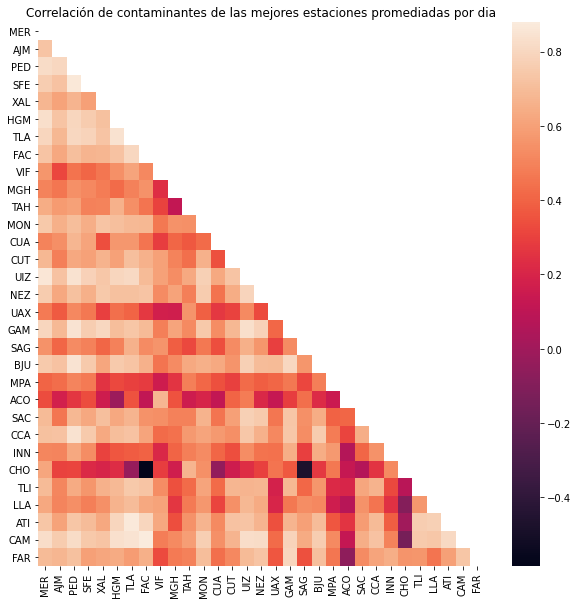

In [7]:
plt.figure(figsize=(10, 10))
mask_ut=np.triu(np.ones(estacion_poll.corr().shape)).astype(np.bool)
sns.heatmap(estacion_poll.corr(), mask=mask_ut)
plt.title("Correlación de contaminantes de las mejores estaciones promediadas por dia")

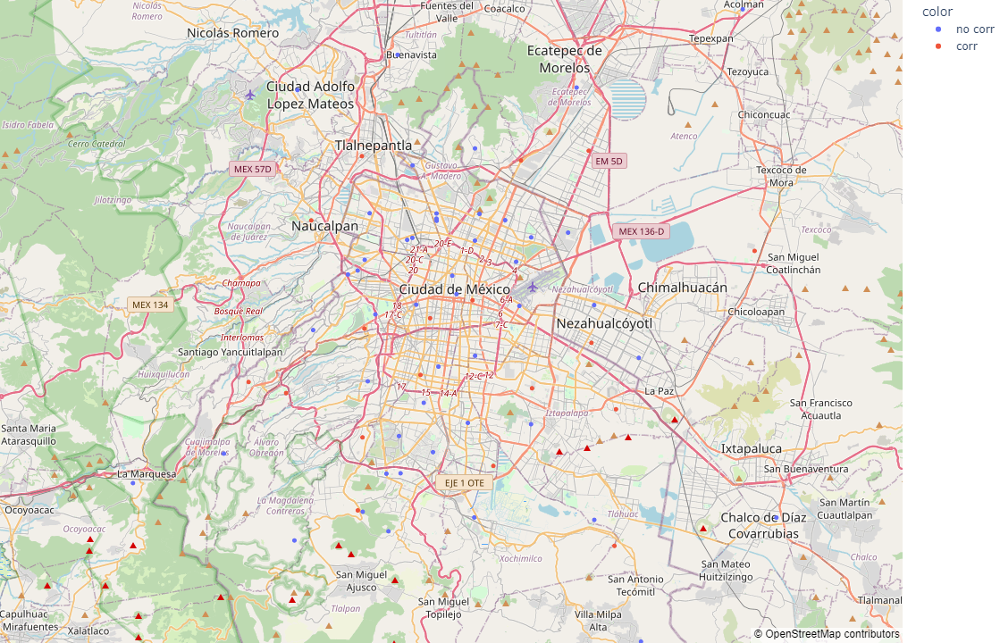

In [8]:
correlations = np.array(estacion_poll.corr())
estaciones_corr = []
for i in range(len(st)):
    for j in range(i+1,len(st)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

C:\Users\Jorge\AppData\Local\Temp/ipykernel_6636/1527723605.py:2: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



Text(0.5, 1.0, 'Correlación meteorológica de las mejores estaciones promediadas por hora')

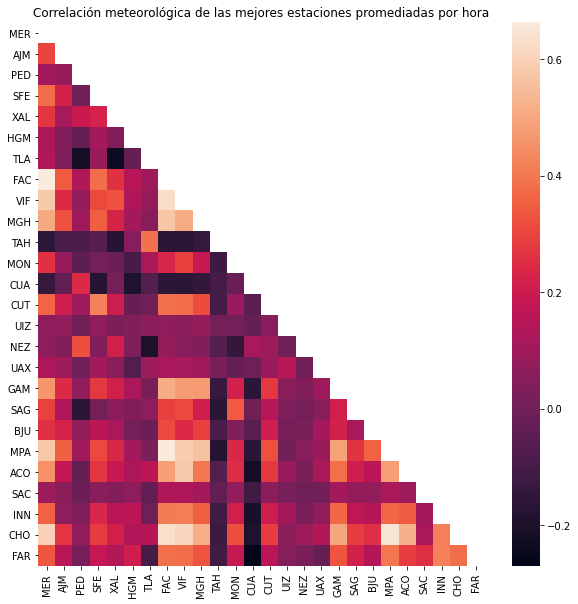

In [11]:
plt.figure(figsize=(10, 10))
mask_ut=np.triu(np.ones(estacion_meteo.corr().shape)).astype(np.bool)
sns.heatmap(estacion_meteo.corr(), mask=mask_ut)
plt.title("Correlación meteorológica de las mejores estaciones promediadas por hora")

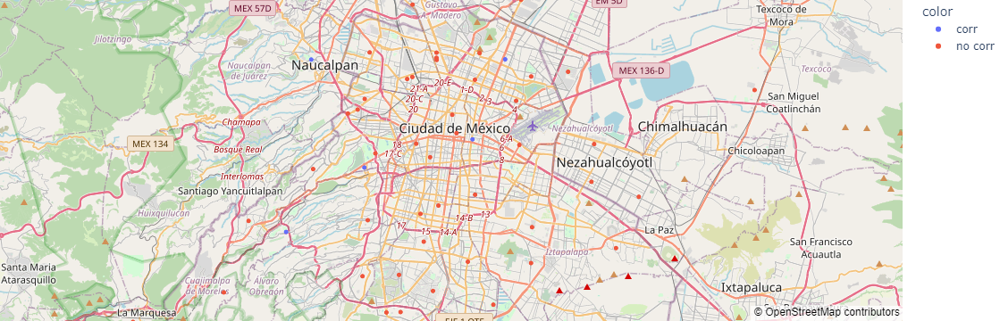

In [12]:
correlations = np.array(estacion_meteo.corr())
estaciones_corr = []
for i in range(len(st_19)-5):
    for j in range(i+1,len(st_19)-5):
        if correlations[i][j] >= 0.4:
            if (st_19[i] != "CCA") and (st_19[i] != "TLI") and (st_19[i] != "LLA") and (st_19[i] != "ATI") and (st_19[i] != "CAM"):
                estaciones_corr.append(st_19[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

C:\Users\Jorge\AppData\Local\Temp/ipykernel_6636/3865194078.py:2: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



Text(0.5, 1.0, 'Correlación de contaminantes de las mejores estaciones promediadas por hora')

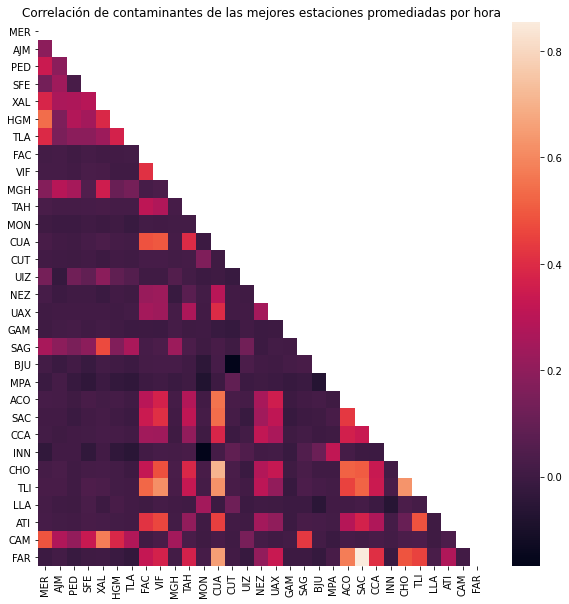

In [13]:
plt.figure(figsize=(10, 10))
mask_ut=np.triu(np.ones(estacion_poll.corr().shape)).astype(np.bool)
sns.heatmap(estacion_poll.corr(), mask=mask_ut)
plt.title("Correlación de contaminantes de las mejores estaciones promediadas por hora")

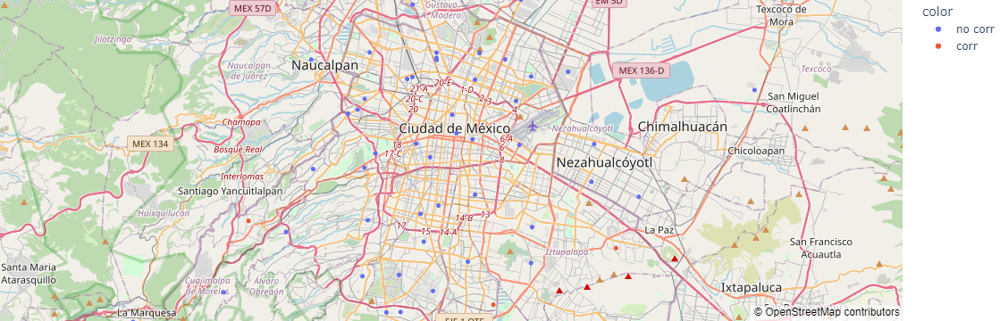

In [14]:
correlations = np.array(estacion_poll.corr())
estaciones_corr = []
for i in range(len(st)):
    for j in range(i+1,len(st)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

#### Primeros datos

Text(0.5, 1.0, 'Correlación meteorológica de las mejores estaciones promediadas por dia')

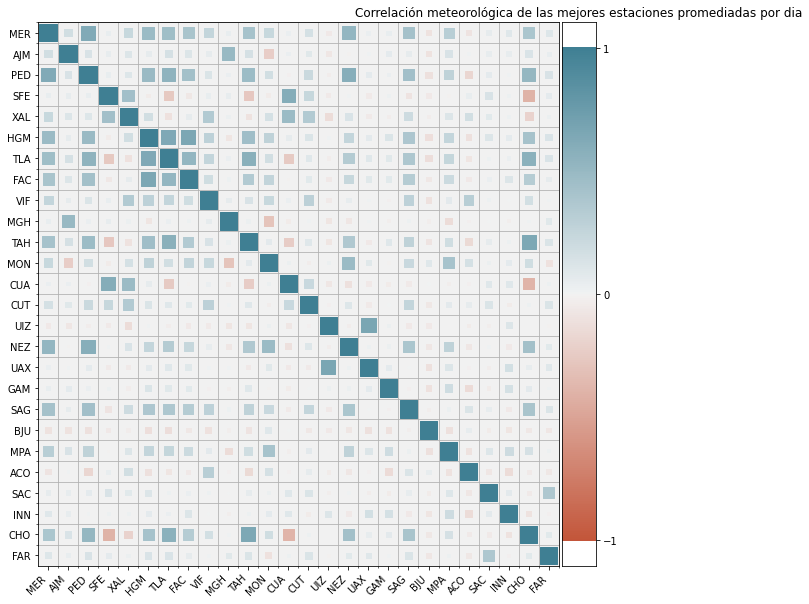

In [58]:
plt.figure(figsize=(10, 10))
corrplot(estacion_meteo.corr(), size_scale=300);
plt.title("Correlación meteorológica de las mejores estaciones promediadas por dia")

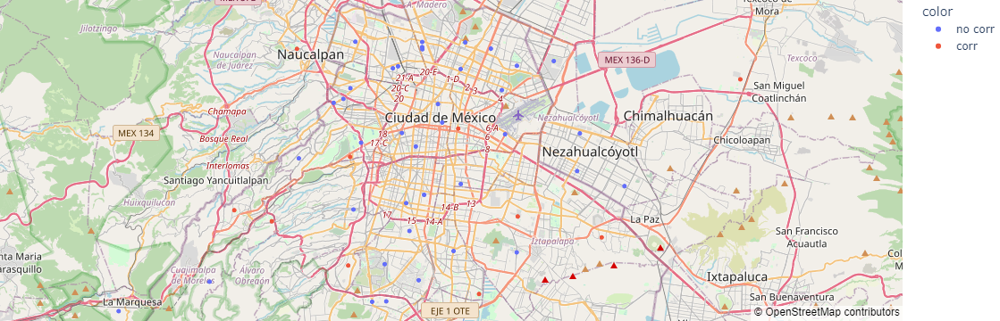

In [59]:
correlations = np.array(estacion_poll.corr())
estaciones_corr = []
for i in range(len(st)):
    for j in range(i+1,len(st)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Text(0.5, 1.0, 'Correlación de contaminantes de las mejores estaciones promediadas por dia')

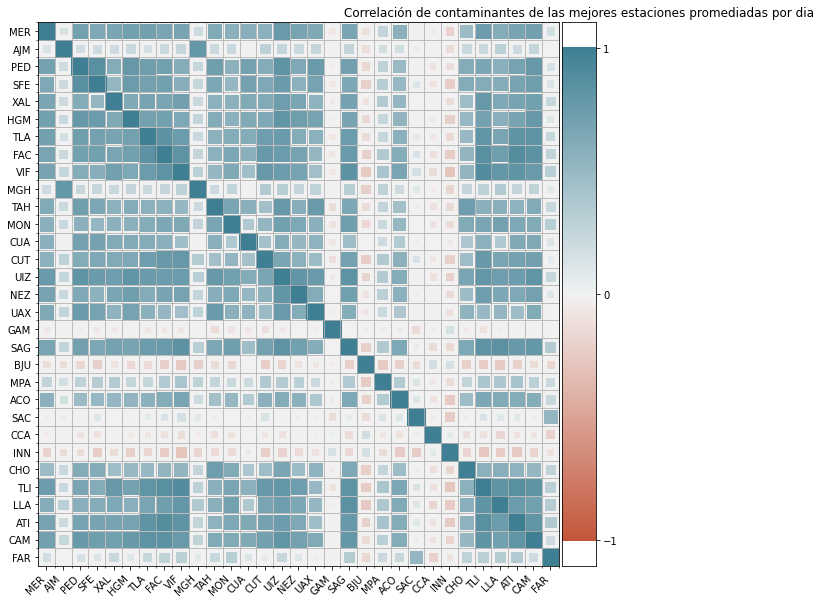

In [60]:
plt.figure(figsize=(10, 10))
corrplot(estacion_poll.corr(), size_scale=300);
plt.title("Correlación de contaminantes de las mejores estaciones promediadas por dia")

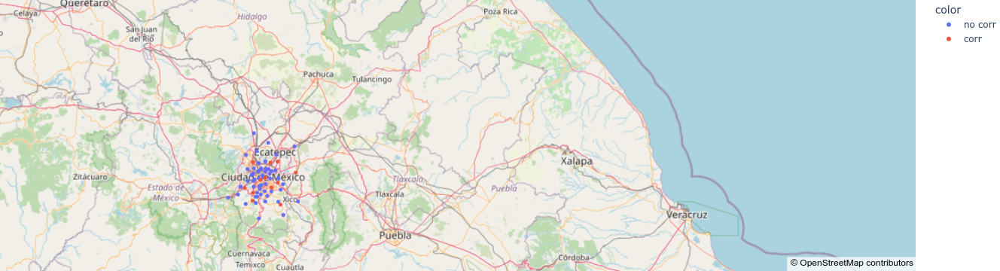

In [61]:
correlations = np.array(estacion_meteo.corr())
estaciones_corr = []
for i in range(len(st_19)-5):
    for j in range(i+1,len(st_19)-5):
        if correlations[i][j] >= 0.4:
            if (st_19[i] != "CCA") and (st_19[i] != "TLI") and (st_19[i] != "LLA") and (st_19[i] != "ATI") and (st_19[i] != "CAM"):
                estaciones_corr.append(st_19[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Text(0.5, 1.0, 'Correlación meteorológica de las mejores estaciones promediadas por hora')

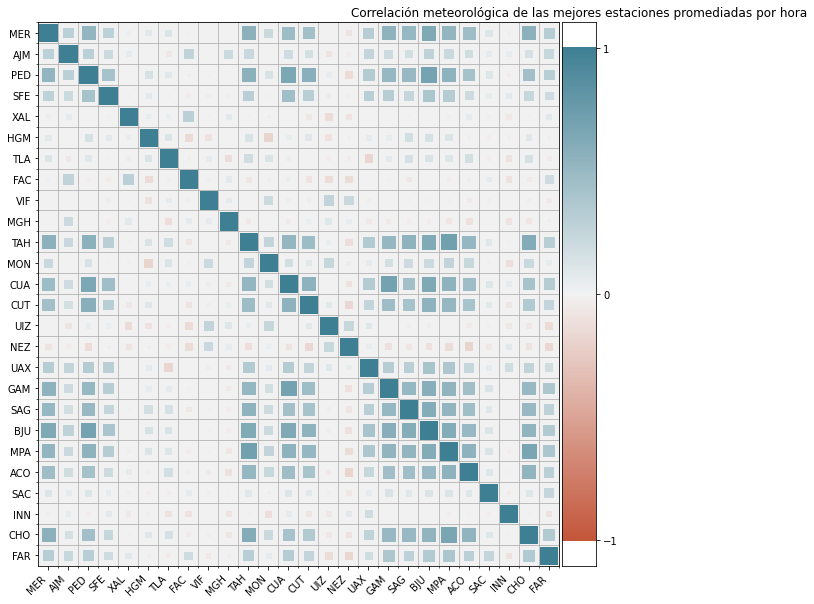

In [75]:
plt.figure(figsize=(10, 10))
corrplot(estacion_meteo.corr(), size_scale=300);
plt.title("Correlación meteorológica de las mejores estaciones promediadas por hora")

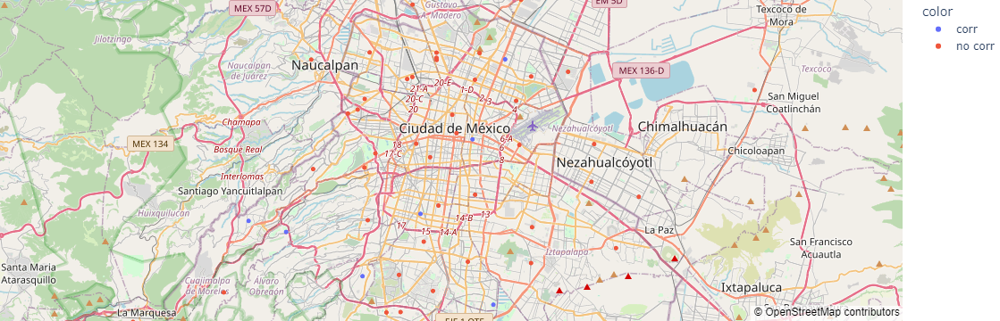

In [76]:
correlations = np.array(estacion_meteo.corr())
estaciones_corr = []
for i in range(len(st_19)-5):
    for j in range(i+1,len(st_19)-5):
        if correlations[i][j] >= 0.4:
            if (st_19[i] != "CCA") and (st_19[i] != "TLI") and (st_19[i] != "LLA") and (st_19[i] != "ATI") and (st_19[i] != "CAM"):
                estaciones_corr.append(st_19[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Text(0.5, 1.0, 'Correlación de contaminantes de las mejores estaciones promediadas por hora')

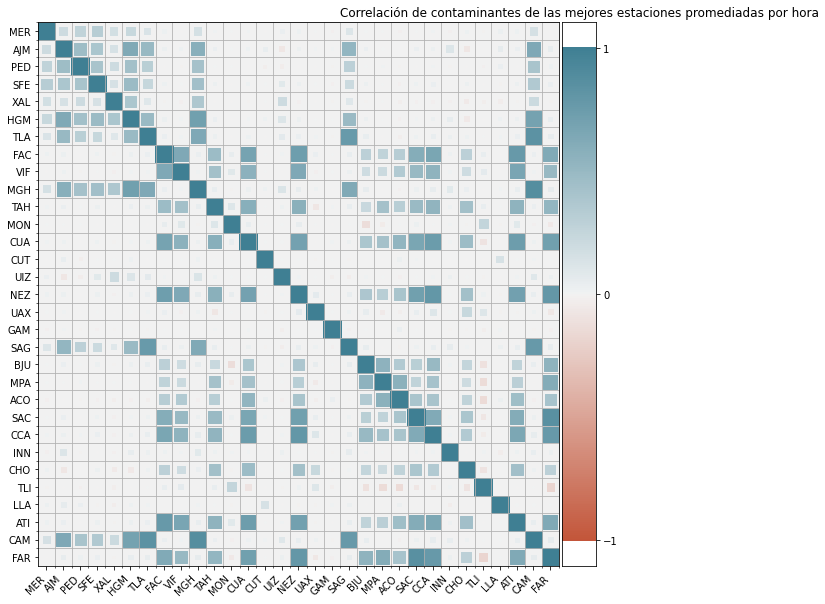

In [77]:
plt.figure(figsize=(10, 10))
corrplot(estacion_poll.corr(), size_scale=300);
plt.title("Correlación de contaminantes de las mejores estaciones promediadas por hora")

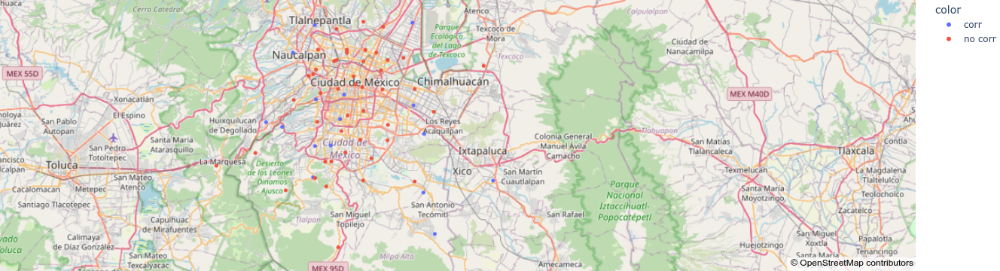

In [79]:
correlations = np.array(estacion_poll.corr())
estaciones_corr = []
for i in range(len(st_19)):
    for j in range(i+1,len(st_19)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st_19[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### Mejores estaciones con valores nulos < 40%

Aquí se tomaron todas las mejores estaciones a lo largo de los años 2014-2020 y se llegó a la misma conclusión que en las estaciones tomadas del análisis de Sara. Solamente que entre estas estaciones hay algunas que dejaron de existir en años posteriores.

Text(0.5, 1.0, 'Correlación meteorológica de las mejores estaciones promediadas por dia')

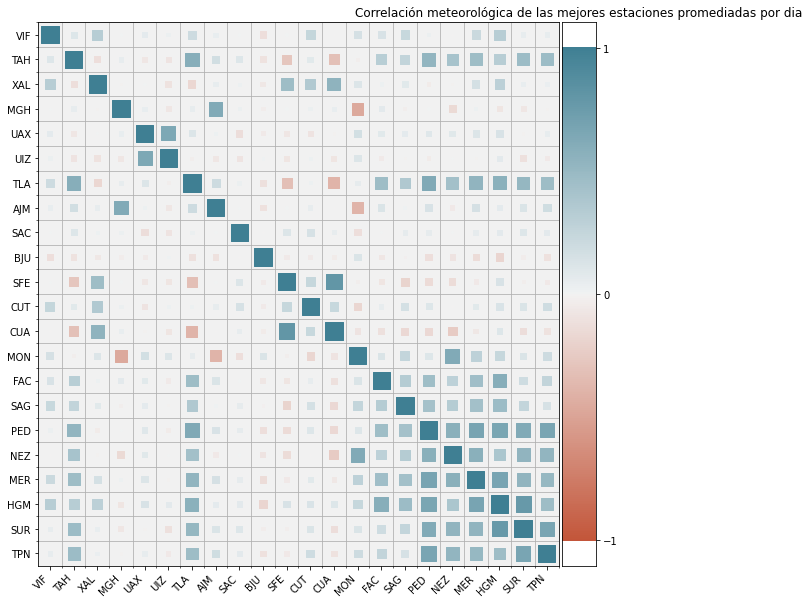

In [4]:
plt.figure(figsize=(10, 10))
corrplot(estacion_meteo.corr(), size_scale=300);
plt.title("Correlación meteorológica de las mejores estaciones promediadas por dia")

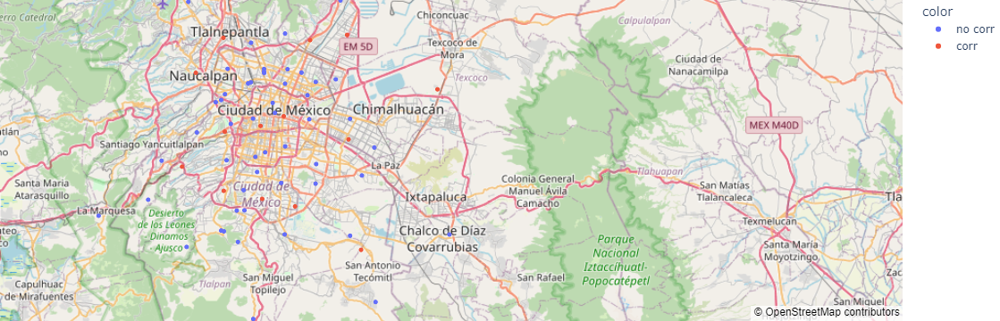

In [47]:
correlations = np.array(estacion_meteo.corr())
estaciones_corr = []
for i in range(len(st)):
    for j in range(i+1,len(st)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Text(0.5, 1.0, 'Correlación de contaminantes de las mejores estaciones promediadas por dia')

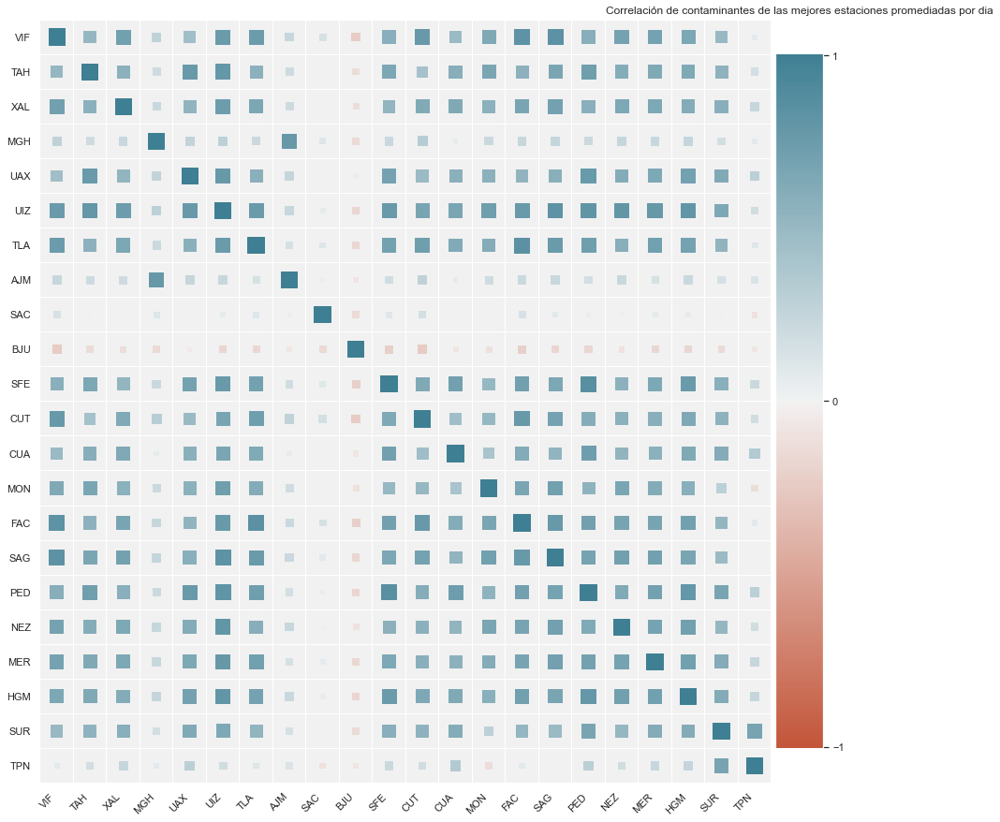

In [52]:
plt.figure(figsize=(15, 15))
corrplot(estacion_poll.corr(), size_scale=300);
plt.title("Correlación de contaminantes de las mejores estaciones promediadas por dia")

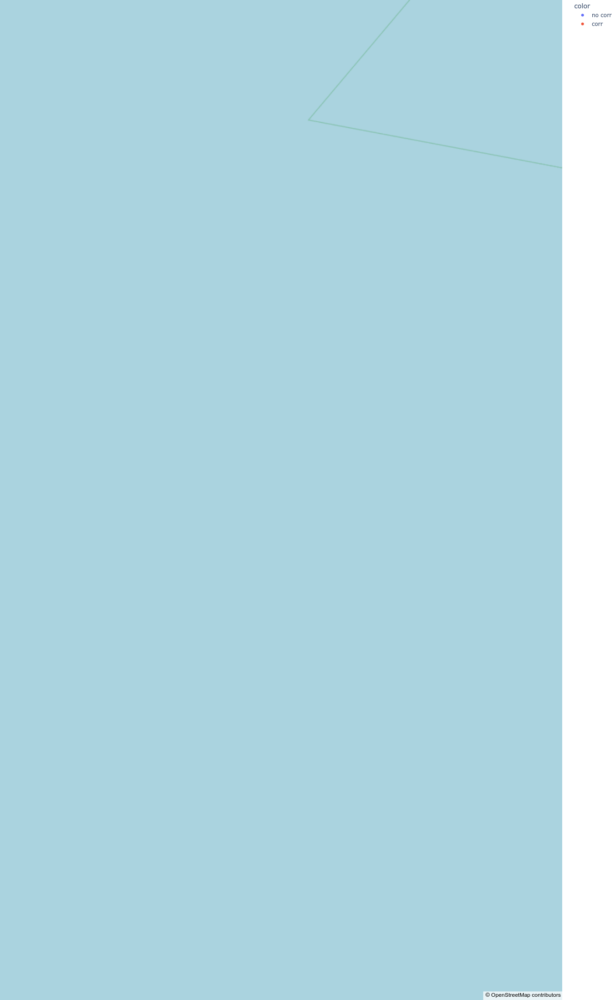

In [48]:
correlations = np.array(estacion_poll.corr())
estaciones_corr = []
for i in range(len(st)):
    for j in range(i+1,len(st)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Text(0.5, 1.0, 'Correlación contaminantes de las mejores estaciones por hora')

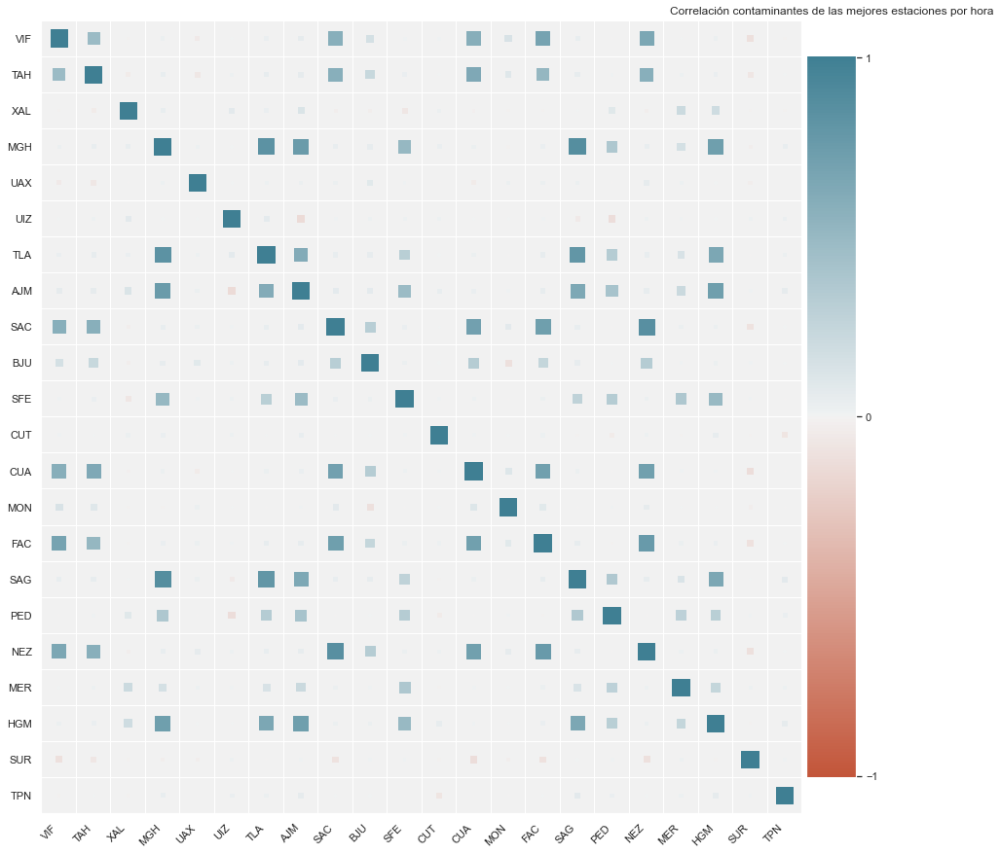

In [39]:
plt.figure(figsize=(15, 15))
corrplot(estacion_poll.corr(), size_scale=300);
plt.title("Correlación contaminantes de las mejores estaciones por hora")

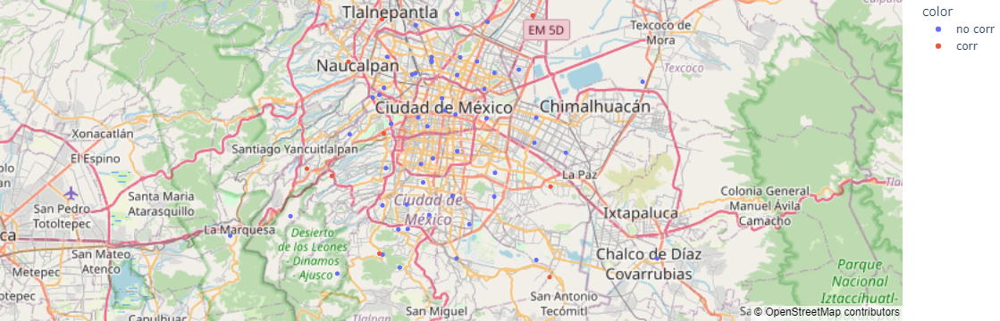

In [45]:
correlations = np.array(estacion_poll.corr())
estaciones_corr = []
for i in range(len(st)):
    for j in range(i+1,len(st)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st[i])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Text(0.5, 1.0, 'Correlación meteorológica de las mejores estaciones por hora')

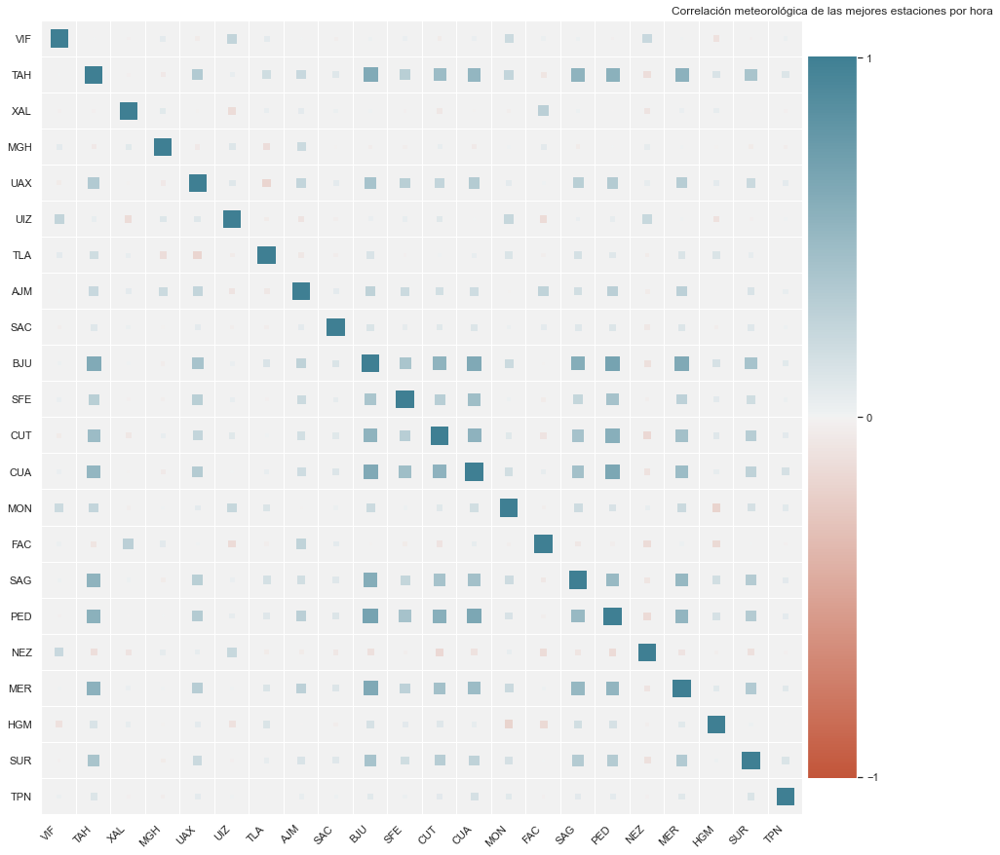

In [40]:
plt.figure(figsize=(15, 15))
corrplot(estacion_meteo.corr(), size_scale=300);
plt.title("Correlación meteorológica de las mejores estaciones por hora")

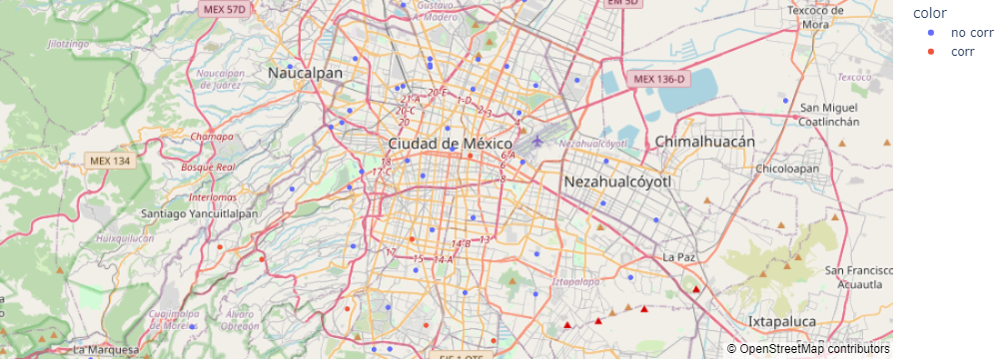

In [51]:
correlations = np.array(estacion_meteo.corr())
estaciones_corr = []
for i in range(len(st)):
    for j in range(i+1,len(st)):
        if correlations[i][j] >= 0.4:
            estaciones_corr.append(st[i])
            estaciones_corr.append(st[j])

colors = {i:('corr' if i in estaciones_corr else 'no corr') for i in location["cve_estac"]}

fig = px.scatter_mapbox(location, lat="latitud", lon="longitud",hover_name="cve_estac", color=colors, zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## Predicciones y dependencias de contaminantes con parametros meteorológicos

Se separaron todos los contaminantes y parámetros meteorológicos

In [4]:
co = poll[poll["id_parameter_id"] == "CO"]
o3 = poll[poll["id_parameter_id"] == "O3"]
nox = poll[poll["id_parameter_id"] == "NOX"]
no2 = poll[poll["id_parameter_id"] == "NO2"]
no = poll[poll["id_parameter_id"] == "NO"]
so2 = poll[poll["id_parameter_id"] == "SO2"]
pm25 = poll[poll["id_parameter_id"] == "PM2.5"]
pm10 = poll[poll["id_parameter_id"] == "PM10"]
pmco = poll[poll["id_parameter_id"] == "PMCO"]

wsp = meteo[meteo["id_parameter_id"] == "WSP"]
rh = meteo[meteo["id_parameter_id"] == "RH"]
tmp = meteo[meteo["id_parameter_id"] == "TMP"]

### Fernando

Modelo de Fernando (Para comparación de resultados)
$$PM10 = \beta_0 + \beta_1\sqrt{O_3} +\beta_2 WSP^2 + \beta_3 \sqrt{\frac{RH}{100}}$$

In [6]:
list1 = np.array(pm10.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["original"])
list2 = np.array(o3.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["original"])
list3 = np.array(wsp.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["original"])
list4 = np.array(rh.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])

corr1, _ = pearsonr(list1[0:1754], list2[0:1754])
corr2, _ = pearsonr(list1[0:1754], list3[0:1754])
corr3, _ = pearsonr(list1[0:1754], list4[0:1754])
print('Pearsons correlation PM10-O3: %.3f' % corr1)
print('Pearsons correlation PM10-WSP: %.3f' % corr2)
print('Pearsons correlation PM10-RH: %.3f' % corr3)

Pearsons correlation PM10-O3: 0.352
Pearsons correlation PM10-WSP: -0.275
Pearsons correlation PM10-RH: -0.501


In [25]:
X = pd.DataFrame(np.array([np.sqrt(list2[0:1754]), list3[0:1754]**2, np.sqrt(list4[0:1754]/100)]).T,columns=["o3","wsp","rh"])
y = list1[0:1754]

X = sm.add_constant(X)
est = sm.OLS(y, X).fit()
est.summary()


c:\users\jorge\appdata\local\programs\python\python39\lib\site-packages\statsmodels\tsa\tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.403
Model:                            OLS   Adj. R-squared:                  0.402
Method:                 Least Squares   F-statistic:                     393.6
Date:                Fri, 10 Sep 2021   Prob (F-statistic):          2.28e-195
Time:                        20:36:55   Log-Likelihood:                -7143.0
No. Observations:                1754   AIC:                         1.429e+04
Df Residuals:                    1750   BIC:                         1.432e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        113.1886      4.913     23.038      0.000     103.552     122.825
o3             2.2424      0.412      5.437      0.000       1.434       3.051
wsp           -2.3956      0.130    -18.485      0.000      -2.650      -2.141
rh           -91.4589      4.032    -22.686      0.000     -99.366     -83.552
==============================================================================
Omnibus:                      277.105   Durbin-Watson:                   0.975
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              542.436
Skew:                           0.953   Prob(JB):                    1.63e-118
Kurtosis:                       4.947   Cond. No.                         154.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [29]:
print(pd.DataFrame(np.array([list1[0:1754],np.sqrt(list2[0:1754]), list3[0:1754]**2, np.sqrt(list4[0:1754]/100)]).T,columns=["pm10","o3","wsp","rh"]).corr())

          pm10        o3       wsp        rh
pm10  1.000000  0.410560 -0.280005 -0.504754
o3    0.410560  1.000000 -0.094194 -0.510827
wsp  -0.280005 -0.094194  1.000000 -0.170580
rh   -0.504754 -0.510827 -0.170580  1.000000


In [31]:
X = pd.DataFrame(np.array([np.sqrt(list2[0:1754]), list3[0:1754]**2, np.sqrt(list4[0:1754]/100)]).T,columns=["o3","wsp","rh"])
y = list1[0:1754]

X = sm.add_constant(X)
est = sm.OLS(y, X).fit()
est.summary()

c:\users\jorge\appdata\local\programs\python\python39\lib\site-packages\statsmodels\tsa\tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.345
Model:                            OLS   Adj. R-squared:                  0.343
Method:                 Least Squares   F-statistic:                     306.6
Date:                Fri, 10 Sep 2021   Prob (F-statistic):          5.82e-160
Time:                        21:12:16   Log-Likelihood:                -7070.2
No. Observations:                1754   AIC:                         1.415e+04
Df Residuals:                    1750   BIC:                         1.417e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         99.4546      4.193     23.719      0.000      91.231     107.678
o3             0.9331      0.370      2.520      0.012       0.207       1.659
wsp           -2.5386      0.130    -19.536      0.000      -2.793      -2.284
rh           -69.8835      3.485    -20.055      0.000     -76.718     -63.049
==============================================================================
Omnibus:                      300.183   Durbin-Watson:                   1.007
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              606.882
Skew:                           1.010   Prob(JB):                    1.65e-132
Kurtosis:                       5.055   Cond. No.                         127.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [32]:
print(pd.DataFrame(np.array([list1[0:1754],np.sqrt(list2[0:1754]), list3[0:1754]**2, np.sqrt(list4[0:1754]/100)]).T,columns=["pm10","o3","wsp","rh"]).corr())

          pm10        o3       wsp        rh
pm10  1.000000  0.322007 -0.286652 -0.441005
o3    0.322007  1.000000  0.041766 -0.573413
wsp  -0.286652  0.041766  1.000000 -0.203231
rh   -0.441005 -0.573413 -0.203231  1.000000


In [3]:
meteo["id_parameter_id"].unique()

array(['WSP', 'TMP', 'WDR', 'RH'], dtype=object)

In [4]:
poll["id_parameter_id"].unique()

array(['CO', 'O3', 'NOX', 'NO2', 'NO', 'SO2', 'PM2.5', 'PM10', 'PMCO'],
      dtype=object)

In [7]:
for par in [pm10,pm25,rh,tmp,no]:
    print(np.array(par).shape)

(623868, 4)
(518378, 4)
(752736, 4)
(752736, 4)
(728758, 4)


## Correlación entre PM10, RH, NO

$$PM10 = \beta_0 + \beta_1\sqrt{NO} + \beta_3 \sqrt{\frac{RH}{100}}$$

Se tomaron  en algunos casos la mediana para PM10 y NO y el promedio para RH y TMP, según correspondía a su distribución (veáse `analysis6.ipynb`, y en otros casos solo el promedio para cada parámetro, y se observó que el modelo se comportaba de mejor manera con todos los parámetros promediados

In [16]:
list1 = np.array(pm10.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["original"])
list2 = np.array(rh.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
list3 = np.array(tmp.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
list4 = np.array(no.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["original"])

te = pd.DataFrame(np.array([list1[0:623868],list2[0:623868],list3[0:623868],list4[0:623868]]).T, columns=["PM10","RH","TMP", "NO"])
print(te.corr())

          PM10        RH       TMP        NO
PM10  1.000000 -0.480550  0.000628  0.209684
RH   -0.480550  1.000000 -0.382603  0.243339
TMP   0.000628 -0.382603  1.000000 -0.532783
NO    0.209684  0.243339 -0.532783  1.000000


In [19]:
list1 = np.array(pm10.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
list2 = np.array(rh.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
list3 = np.array(tmp.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
list4 = np.array(no.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])

te = pd.DataFrame(np.array([list1[0:623868],list2[0:623868],list3[0:623868],list4[0:623868]]).T, columns=["PM10","RH","TMP", "NO"])
print(te.corr())

          PM10        RH       TMP        NO
PM10  1.000000 -0.531779  0.018066  0.575440
RH   -0.531779  1.000000 -0.382603 -0.247225
TMP   0.018066 -0.382603  1.000000 -0.270753
NO    0.575440 -0.247225 -0.270753  1.000000


In [20]:
X = pd.DataFrame(np.array([np.sqrt(list4[0:1754]), np.sqrt(list2[0:1754]/100)]).T,columns=["no","rh"])
y = list1[0:1754]

X = sm.add_constant(X)
est = sm.OLS(y, X).fit()
est.summary()

c:\users\jorge\appdata\local\programs\python\python39\lib\site-packages\statsmodels\tsa\tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.507
Model:                            OLS   Adj. R-squared:                  0.506
Method:                 Least Squares   F-statistic:                     899.1
Date:                Mon, 04 Oct 2021   Prob (F-statistic):          2.24e-269
Time:                        19:00:51   Log-Likelihood:                -6957.3
No. Observations:                1754   AIC:                         1.392e+04
Df Residuals:                    1751   BIC:                         1.394e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         65.4532      2.899     22.575      0.000      59.767      71.140
no             8.1077      0.293     27.667      0.000       7.533       8.682
rh           -71.3245      3.194    -22.329      0.000     -77.589     -65.060
==============================================================================
Omnibus:                      200.540   Durbin-Watson:                   0.922
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              365.825
Skew:                           0.745   Prob(JB):                     3.65e-80
Kurtosis:                       4.669   Cond. No.                         62.1
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Puntos azules: Datos experimentales

Puntos rojos: Datos del modelo

Secciónes verdes: Intervalos de confianza

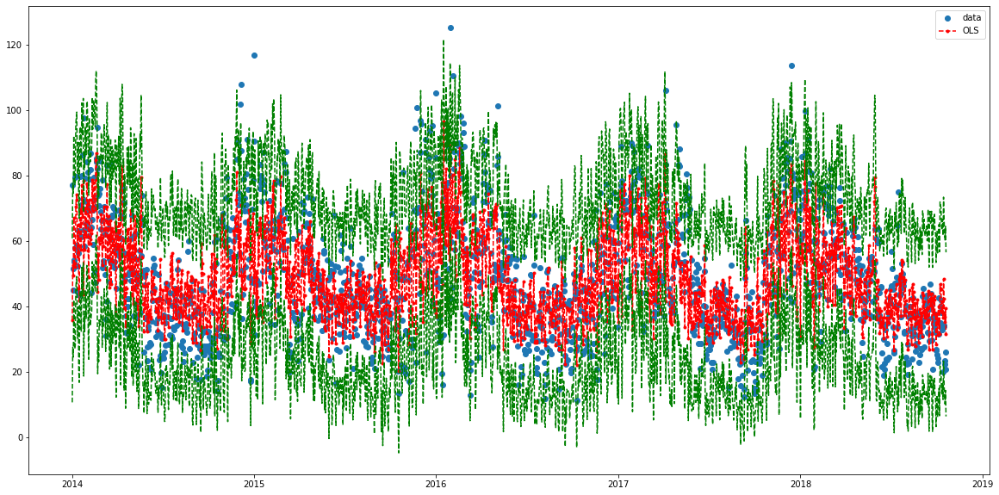

In [21]:
pred_ols = est.get_prediction()
iv_l = pred_ols.summary_frame()["obs_ci_lower"]
iv_u = pred_ols.summary_frame()["obs_ci_upper"]
x = pm10.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["dateUTCShiftedDown"][0:1754]
fig, ax = plt.subplots(figsize=(20, 10))

ax.plot(x, y, "o", label="data")
ax.plot(x, est.fittedvalues, "r--.", label="OLS")
ax.plot(x, iv_u, "g--")
ax.plot(x, iv_l, "g--")
ax.legend(loc="best")

In [23]:
list1 = np.array(pm25.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
X = pd.DataFrame(np.array([np.sqrt(list4[0:1754]), list3[0:1754], np.sqrt(list2[0:1754]/100)]).T,columns=["no","tmp","rh"])
y = list1[0:1754]

X = sm.add_constant(X)
est = sm.OLS(y, X).fit()
est.summary()

c:\users\jorge\appdata\local\programs\python\python39\lib\site-packages\statsmodels\tsa\tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.158
Model:                            OLS   Adj. R-squared:                  0.156
Method:                 Least Squares   F-statistic:                     109.3
Date:                Mon, 04 Oct 2021   Prob (F-statistic):           7.53e-65
Time:                        19:01:54   Log-Likelihood:                -6320.8
No. Observations:                1754   AIC:                         1.265e+04
Df Residuals:                    1750   BIC:                         1.267e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         11.0293      3.606      3.058      0.002       3.956      18.102
no             3.4017      0.219     15.503      0.000       2.971       3.832
tmp            0.1334      0.102      1.311      0.190      -0.066       0.333
rh            -4.7974      2.493     -1.924      0.054      -9.687       0.092
==============================================================================
Omnibus:                      463.060   Durbin-Watson:                   0.961
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2019.690
Skew:                           1.199   Prob(JB):                         0.00
Kurtosis:                       7.679   Cond. No.                         374.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

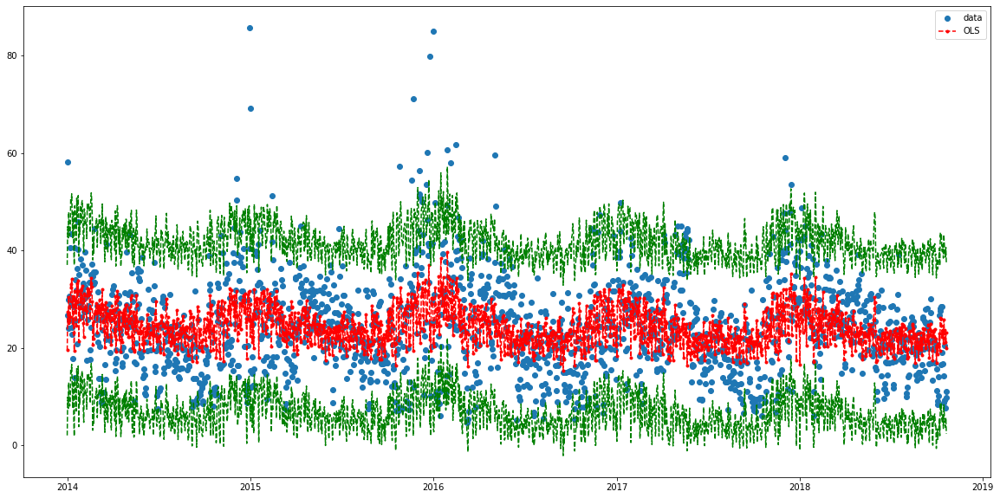

In [24]:
pred_ols = est.get_prediction()
iv_l = pred_ols.summary_frame()["obs_ci_lower"]
iv_u = pred_ols.summary_frame()["obs_ci_upper"]
x = pm25.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["dateUTCShiftedDown"][0:1754]
fig, ax = plt.subplots(figsize=(20, 10))

ax.plot(x, y, "o", label="data")
ax.plot(x, est.fittedvalues, "r--.", label="OLS")
ax.plot(x, iv_u, "g--")
ax.plot(x, iv_l, "g--")
ax.legend(loc="best")

## Correlación entre PM2.5, RH, WSP

$$PM2.5 = \beta_0 + \beta_1RH +\beta_2 WSP$$

Este modelo falta encontrar un buen ajuste, sin embargo se encontró una correlación entre dichos parámetros

In [44]:
list1 = np.array(pm25.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["original"])
list2 = np.array(rh.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
list3 = np.array(wsp.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["original"])

te = pd.DataFrame(np.array([list1[0:623868],list2[0:623868],list3[0:623868]]).T, columns=["PM2.5","RH","WSP"])
print(te.corr())

          PM2.5        RH       WSP
PM2.5  1.000000 -0.184001 -0.447920
RH    -0.184001  1.000000 -0.232384
WSP   -0.447920 -0.232384  1.000000


In [46]:
list1 = np.array(pm25.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
list2 = np.array(rh.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
list3 = np.array(wsp.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])

te = pd.DataFrame(np.array([list1[0:623868],list2[0:623868],list3[0:623868]]).T, columns=["PM2.5","RH","WSP"])
print(te.corr())

          PM2.5        RH       WSP
PM2.5  1.000000 -0.201845 -0.455863
RH    -0.201845  1.000000 -0.212909
WSP   -0.455863 -0.212909  1.000000


In [2]:
1800/33

54.54545454545455

In [47]:
X = pd.DataFrame(np.array([list3[0:1754], list2[0:1754]/100]).T,columns=["wsp","rh"])
y = list1[0:1754]

X = sm.add_constant(X)
est = sm.OLS(y, X).fit()
est.summary()

c:\users\jorge\appdata\local\programs\python\python39\lib\site-packages\statsmodels\tsa\tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.342
Model:                            OLS   Adj. R-squared:                  0.341
Method:                 Least Squares   F-statistic:                     454.1
Date:                Mon, 04 Oct 2021   Prob (F-statistic):          1.36e-159
Time:                        19:07:38   Log-Likelihood:                -6104.9
No. Observations:                1754   AIC:                         1.222e+04
Df Residuals:                    1751   BIC:                         1.223e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         60.1407      1.249     48.160      0.000      57.692      62.590
wsp          -10.7379      0.377    -28.494      0.000     -11.477      -9.999
rh           -21.6367      1.400    -15.450      0.000     -24.383     -18.890
==============================================================================
Omnibus:                      606.360   Durbin-Watson:                   1.124
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             3411.628
Skew:                           1.514   Prob(JB):                         0.00
Kurtosis:                       9.125   Cond. No.                         24.3
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

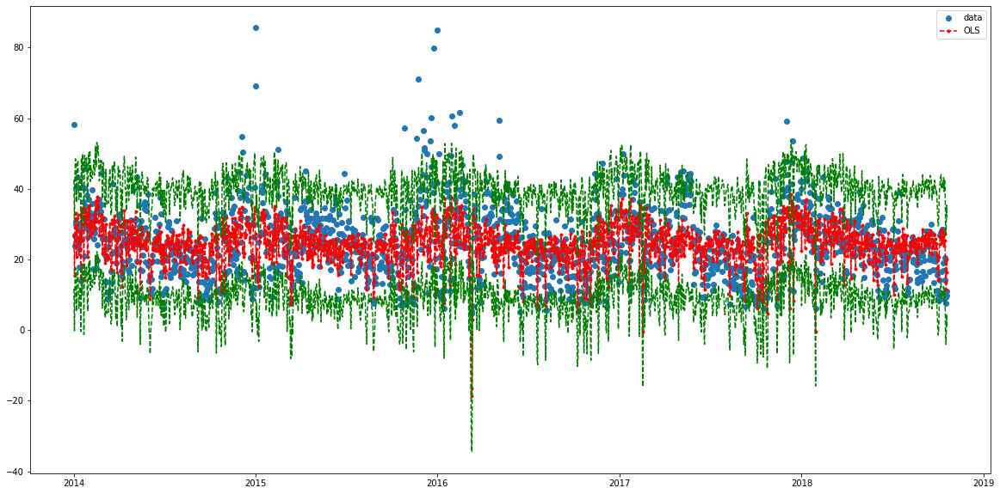

In [48]:
pred_ols = est.get_prediction()
iv_l = pred_ols.summary_frame()["obs_ci_lower"]
iv_u = pred_ols.summary_frame()["obs_ci_upper"]
x = pm25.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].median().to_frame().reset_index()["dateUTCShiftedDown"][0:1754]
fig, ax = plt.subplots(figsize=(20, 10))

ax.plot(x, y, "o", label="data")
ax.plot(x, est.fittedvalues, "r--.", label="OLS")
ax.plot(x, iv_u, "g--")
ax.plot(x, iv_l, "g--")
ax.legend(loc="best")

In [40]:
list1 = np.array(pm10.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["original"])
X = pd.DataFrame(np.array([list3[0:1754], list2[0:1754]/100]).T,columns=["wsp","rh"])
y = list1[0:1754]

X = sm.add_constant(X)
est = sm.OLS(y, X).fit()
est.summary()

c:\users\jorge\appdata\local\programs\python\python39\lib\site-packages\statsmodels\tsa\tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.456
Model:                            OLS   Adj. R-squared:                  0.455
Method:                 Least Squares   F-statistic:                     734.0
Date:                Mon, 04 Oct 2021   Prob (F-statistic):          3.01e-232
Time:                        19:07:03   Log-Likelihood:                -7042.9
No. Observations:                1754   AIC:                         1.409e+04
Df Residuals:                    1751   BIC:                         1.411e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        122.8319      2.070     59.327      0.000     118.771     126.893
wsp          -14.1877      0.650    -21.821      0.000     -15.463     -12.912
rh           -85.6940      2.404    -35.653      0.000     -90.408     -80.980
==============================================================================
Omnibus:                      241.542   Durbin-Watson:                   1.062
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              462.818
Skew:                           0.853   Prob(JB):                    3.17e-101
Kurtosis:                       4.850   Cond. No.                         22.7
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

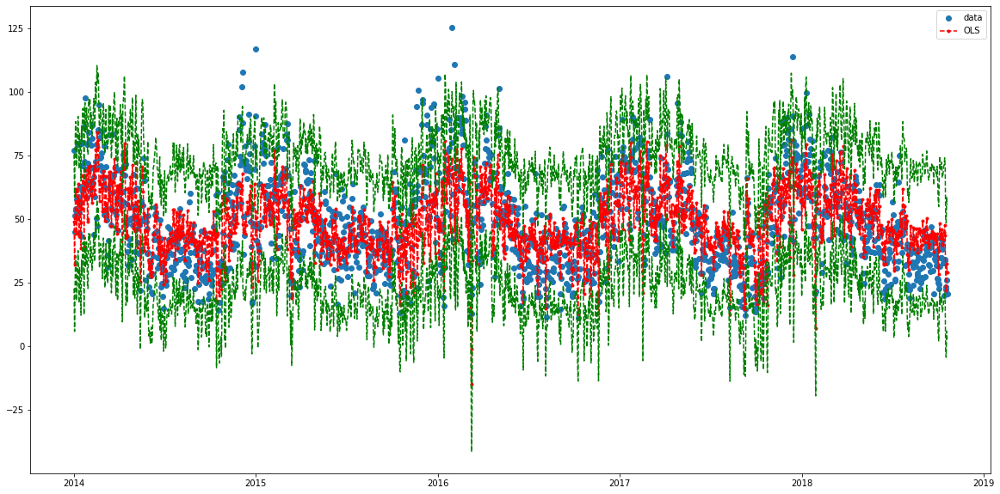

In [41]:
pred_ols = est.get_prediction()
iv_l = pred_ols.summary_frame()["obs_ci_lower"]
iv_u = pred_ols.summary_frame()["obs_ci_upper"]
x = pm10.groupby(by=[pd.Grouper(key="dateUTCShiftedDown",freq = "D")])["original"].mean().to_frame().reset_index()["dateUTCShiftedDown"][0:1754]
fig, ax = plt.subplots(figsize=(20, 10))

ax.plot(x, y, "o", label="data")
ax.plot(x, est.fittedvalues, "r--.", label="OLS")
ax.plot(x, iv_u, "g--")
ax.plot(x, iv_l, "g--")
ax.legend(loc="best")